<a href="https://colab.research.google.com/github/Leanse1/Video-Segmentation-and-Detection/blob/main/Video_Segmentation_%26_Detection_using_YOLONAS_SAM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Image and Video segmentation using SAM and YOLO-NAS**

Steps:
 1. Install All the Required Packages
 2. Import All the Required Libraries
 3. Download Some Demo Videos From Drive into the Google Colab Notebook
 4. Load the Input Video and calculate the Frame Width and Frame Height
 5. Download the Pre-Trained YOLO-NAS Model Weights
 6. Object Detection with YOLO-NAS
 7. Display the Output Demo Video
 8. Download the Checkpoint for the Segment Anything Model (SAM)
 9. Initialize SAM Automatic Mask Generator parameters and Draw Segmented Mask
 10. Load the Segment Anything Model Checkpoint and return the Segment Anything Model
 11. Video Segmentation using YOLO-NAS and SAM
 12. Display the Output Video
 13. Image Segmentation with YOLO-NAS and SAM


#**Step 01: Install All the Required Packages**

In [ ]:
!pip install -q super_gradients
!pip install -q segment_anything
!pip install -q supervision

#**Step 02:Import All the Required Libraries**

In [ ]:
import cv2
import torch
import math
import numpy as np
from numpy import random
import supervision as sv
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
from super_gradients.training import models
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

#**Step 03: Download Some Demo Videos From Drive into the Google Colab Notebook**

In [ ]:
!gdown "https://drive.google.com/uc?id=1W37PKVxDNl1wngrvdMgK8RStxPWwMYCM&confirm=t"
!gdown "https://drive.google.com/uc?id=1rQq9Uq8f-KjoWX0Zn_-_9KOLcLX4hurX&confirm=t"
!gdown "https://drive.google.com/uc?id=1_yvsJOqtdi8FelROqzmRTjl9-S1bEt6g&confirm=t"
!gdown "https://drive.google.com/uc?id=1340mqENg7yzDKtD28xVpHkrYBmbYxiS_&confirm=t"
!gdown "https://drive.google.com/uc?id=1oHW1XFMi9S3alNowylQKS3Y8FeF27TFo&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1W37PKVxDNl1wngrvdMgK8RStxPWwMYCM&confirm=t
To: /content/carvideo.mp4
100% 951k/951k [00:00<00:00, 76.1MB/s]
Downloading...
From: https://drive.google.com/uc?id=1rQq9Uq8f-KjoWX0Zn_-_9KOLcLX4hurX&confirm=t
To: /content/Football_Video.mp4
100% 5.11M/5.11M [00:00<00:00, 188MB/s]
Downloading...
From: https://drive.google.com/uc?id=1_yvsJOqtdi8FelROqzmRTjl9-S1bEt6g&confirm=t
To: /content/DrpoedShot.mp4
100% 6.86M/6.86M [00:00<00:00, 92.4MB/s]
Downloading...
From: https://drive.google.com/uc?id=1340mqENg7yzDKtD28xVpHkrYBmbYxiS_&confirm=t
To: /content/video212.mp4
100% 1.28M/1.28M [00:00<00:00, 164MB/s]
Downloading...
From: https://drive.google.com/uc?id=1oHW1XFMi9S3alNowylQKS3Y8FeF27TFo&confirm=t
To: /content/Basketball_video.mp4
100% 7.85M/7.85M [00:00<00:00, 77.0MB/s]


#**Step 04: Load the Input Video and calculate the Frame Width and Frame Height**

In [ ]:
cap=cv2.VideoCapture("/content/Football_Video.mp4")
frame_width=int(cap.get(3))
frame_height=int(cap.get(4))

#**Step 05: Download the Pre-Trained YOLO-NAS Model Weights**

In [ ]:
device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")
model = models.get('yolo_nas_s', pretrained_weights="coco").to(device)

[2023-08-01 16:47:49] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.


#**Step 06: Object Detection with YOLO-NAS**

In [ ]:
names = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck", "boat", "traffic light", "fire hydrant", "stop sign", "parking meter", "bench", "bird", "cat", "dog", "horse", "sheep", "cow", "elephant", "bear", "zebra", "giraffe", "backpack", "umbrella","handbag", "tie", "suitcase", "frisbee", "skis", "snowboard", "sports ball", "kite", "baseball bat","baseball glove", "skateboard", "surfboard", "tennis racket", "bottle", "wine glass", "cup","fork", "knife", "spoon", "bowl", "banana", "apple", "sandwich", "orange", "broccoli","carrot", "hot dog", "pizza", "donut", "cake", "chair", "sofa", "pottedplant", "bed","diningtable", "toilet", "tvmonitor", "laptop", "mouse", "remote", "keyboard", "cell phone","microwave", "oven", "toaster", "sink", "refrigerator", "book", "clock", "vase", "scissors","teddy bear", "hair drier", "toothbrush" ]
out = cv2.VideoWriter('Output1.avi', cv2.VideoWriter_fourcc('M', 'J', 'P', 'G'), 10, (frame_width, frame_height))
count = 0
while True:
    ret, frame = cap.read()
    count += 1
    if ret:
        result = list(model.predict(frame, conf=0.35))[0]
        bbox_xyxys = result.prediction.bboxes_xyxy.tolist()
        confidences = result.prediction.confidence
        labels = result.prediction.labels.tolist()
        for (bbox_xyxy, confidence, cls) in zip(bbox_xyxys, confidences, labels):
            bbox = np.array(bbox_xyxy)
            x1, y1, x2, y2 = bbox[0], bbox[1], bbox[2], bbox[3]
            x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)
            classname = int(cls)
            class_name = names[classname]
            conf = math.ceil((confidence*100))/100
            label = f'{class_name}{conf}'
            print("Frame N", count, "", x1, y1,x2, y2)
            t_size = cv2.getTextSize(label, 0, fontScale = 1, thickness=2)[0]
            c2 = x1 + t_size[0], y1 - t_size[1] -3
            cv2.rectangle(frame, (x1, y1), c2, [255, 144, 30], -1, cv2.LINE_AA)
            cv2.putText(frame, label, (x1, y1-2), 0, 1, [255, 255, 255], thickness=1, lineType = cv2.LINE_AA)
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 255), 3)
            resize_frame = cv2.resize(frame, (0, 0), fx=0.5, fy=0.5, interpolation=cv2.INTER_AREA)
        out.write(frame)
    else:
        break

out.release()
cap.release()

#**Step 07: Display the Output Demo Video**

In [ ]:
!rm '/content/result_compressed.mp4'


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/Output1.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**Step 08: Image and Video Segmentation using YOLO-NAS and Segment Anything Model (SAM)**

#**Download the Checkpoint for the Segment Anything Model**

In [ ]:
!wget 'https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth'

In [ ]:
sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = 'vit_h'
device = 'cuda' if torch.cuda.is_available() else 'cpu'

#**Step 09: Initialize SAM Automatic Mask Generator parameters and Draw Segmented Mask**

In [ ]:
#Load the Segment Anything Model Checkpoint and return the Segment Anything Model
def load_sam():
    sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
    sam.to(device=device)
    return sam

def show_mask(mask, ax, random_color=False):
  if random_color:
      color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
  else:
      color = np.array([30/255, 144/255, 255/255, 0.6])
  h, w = mask.shape[-2:]
  mask_image = mask.reshape(h, w, 1)  * color.reshape(1, 1, -1)
  return mask_image

#Initialize Sam automatic mask generator parameters - > parameters can be modified for more optimized performance.
def mask_generator():

    mask_generator_ = SamAutomaticMaskGenerator(
        model=load_sam(),
        points_per_side=32,
        pred_iou_thresh=0.9,
        stability_score_thresh=0.96,
        crop_n_layers=1,
        crop_n_points_downscale_factor=2,
        min_mask_region_area=100,
    )
    return mask_generator_

def get_input_boxes(bboxes, class_ids, frame):
  for _, (box, class_id) in enumerate(zip(bboxes, class_ids)):
      label = names[class_id]
      c1, c2 = (int(box[0]), int(box[1])), (int(box[2]), int(box[3]))
      cv2.rectangle(frame, c1, c2, color=(0, 28, 136), thickness=2, lineType=cv2.LINE_AA)
      if label:
          tl=2
          tf = max(tl - 1, 1)  # font thickness
          t_size = cv2.getTextSize(str(label), 0, fontScale=tl / 3, thickness=tf)[0]
          c2 = c1[0] + t_size[0], c1[1] - t_size[1] - 3
          cv2.rectangle(frame, c1, c2, color=(0, 28, 136),thickness=-1, lineType=cv2.LINE_AA)  # filled
          cv2.putText(frame, str(label), (c1[0], c1[1] - 2), 0, tl / 3,
                      [225, 255, 255], thickness=tf, lineType=cv2.LINE_AA)
  input_tensor_box = torch.tensor(bboxes, device=device)
  return input_tensor_box

def segment_object(bbox, frame, class_ids, filter_classes):
    img_rgb = frame.copy()
    mask_predictor = SamPredictor(sam)
    mask_predictor.set_image(frame)
    input_boxes = get_input_boxes(bbox,  class_ids, frame)
    transformed_boxes = mask_predictor.transform.apply_boxes_torch(input_boxes, img_rgb.shape[:2])
    masks, scores, logits = mask_predictor.predict_torch(point_coords=None, point_labels=None, boxes=transformed_boxes, multimask_output=False)
    return masks

def draw_segmented_mask(anns, frame):
  img = frame.copy()
  mask_annotator = sv.MaskAnnotator(color=sv.Color.blue())
  detections = sv.Detections(
    xyxy=sv.mask_to_xyxy(masks=anns),
    mask=anns)
  detections = detections[detections.area == np.max(detections.area)]
  segmented_mask = mask_annotator.annotate(scene=frame, detections=detections)
  return segmented_mask


#**Step 10: Load the Segment Anything Model Checkpoint and return the Segment Anything Model**

In [ ]:
#Load the Segment Anything Model Checkpoint and return the Segment Anything Model
sam = load_sam()

#**Step 11: Video Segmentation using YOLO-NAS and SAM**

In [ ]:
cap=cv2.VideoCapture("/content/carvideo.mp4")
frame_width=int(cap.get(3))
frame_height=int(cap.get(4))

In [ ]:
names = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck", "boat", "traffic light", "fire hydrant", "stop sign", "parking meter", "bench", "bird", "cat", "dog", "horse", "sheep", "cow", "elephant", "bear", "zebra", "giraffe", "backpack", "umbrella","handbag", "tie", "suitcase", "frisbee", "skis", "snowboard", "sports ball", "kite", "baseball bat","baseball glove", "skateboard", "surfboard", "tennis racket", "bottle", "wine glass", "cup","fork", "knife", "spoon", "bowl", "banana", "apple", "sandwich", "orange", "broccoli","carrot", "hot dog", "pizza", "donut", "cake", "chair", "sofa", "pottedplant", "bed","diningtable", "toilet", "tvmonitor", "laptop", "mouse", "remote", "keyboard", "cell phone","microwave", "oven", "toaster", "sink", "refrigerator", "book", "clock", "vase", "scissors","teddy bear", "hair drier", "toothbrush" ]
out = cv2.VideoWriter('Output2.avi', cv2.VideoWriter_fourcc('M', 'J', 'P', 'G'), 10, (frame_width, frame_height))
count = 0
while True:
    ret, frame = cap.read()
    count += 1
    if ret:
        result = list(model.predict(frame, conf=0.5))[0]
        bbox_xyxys = result.prediction.bboxes_xyxy.tolist()
        confidences = result.prediction.confidence
        labels = result.prediction.labels.tolist()
        label = [int(labels) for labels in labels]
        print("Bounding Box Coorinates",bbox_xyxys)
        print("Scores", confidences)
        print("Class IDS", label)
        masks = segment_object(bbox_xyxys, frame, label, filter_classes=None)
        for mask in masks:
          segmented_mask = show_mask(mask.cpu().numpy(), plt.gca(), random_color=True)
          rearranged_mask = np.transpose(segmented_mask[:,:,:3], (2,0,1))
          frame = draw_segmented_mask(rearranged_mask, frame)
        out.write(frame)
        plt.close()
    else:
        break

out.release()
cap.release()

#**Step 12: Display the Output Video**

#**Output Video 1**

In [ ]:
!rm '/content/result_compressed.mp4'


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/Output2.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**Output Video 2**

In [ ]:
!rm '/content/result_compressed.mp4'


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/Output2.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
from google.colab import drive
drive.mount('/content/mydrive/')

In [ ]:
!mv '/content/Output1.avi' '/content/mydrive/MyDrive/AS-One'

#**Output Video 3**

In [ ]:
!rm '/content/result_compressed.mp4'


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/Output4.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**Output Video 4**

In [ ]:
!rm '/content/result_compressed.mp4'


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/Output4.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**Step 13: Image Segmentation with YOLO-NAS and SAM**

In [ ]:
!gdown "https://drive.google.com/uc?id=1rXyJH9ih5mV6TWZ_SeFRxNKF609vsHEM&confirm=t"
!gdown "https://drive.google.com/uc?id=1YiVCSa-XBrPrkjtmKCEfxMyp7Pp2-Aea&confirm=t"
!gdown "https://drive.google.com/uc?id=1rXyJH9ih5mV6TWZ_SeFRxNKF609vsHEM&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1rXyJH9ih5mV6TWZ_SeFRxNKF609vsHEM&confirm=t
To: /content/horses.jpg
100% 133k/133k [00:00<00:00, 89.3MB/s]
Downloading...
From: https://drive.google.com/uc?id=1YiVCSa-XBrPrkjtmKCEfxMyp7Pp2-Aea&confirm=t
To: /content/image1.jpg
100% 214k/214k [00:00<00:00, 113MB/s]
Downloading...
From: https://drive.google.com/uc?id=1rXyJH9ih5mV6TWZ_SeFRxNKF609vsHEM&confirm=t
To: /content/horses.jpg
100% 133k/133k [00:00<00:00, 74.2MB/s]


#**Example 1**

In [ ]:
frame = cv2.imread("/content/image1.jpg")

[2023-08-01 16:58:49] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


Bounding Box Coorinates [[224.49880981445312, 307.1933898925781, 430.03143310546875, 657.4292602539062], [943.5436401367188, 339.9174499511719, 1002.8252563476562, 555.9158935546875], [749.6314697265625, 337.9520263671875, 858.2940063476562, 661.4583129882812], [590.5807495117188, 369.103759765625, 673.9386596679688, 660.7704467773438], [438.50726318359375, 369.5951232910156, 566.8239135742188, 660.1807861328125], [302.4272766113281, 401.48388671875, 426.78851318359375, 602.9874267578125], [836.6744995117188, 348.76177978515625, 909.1243896484375, 633.6477661132812], [711.6744995117188, 89.42610168457031, 827.0931396484375, 275.4520263671875], [473.09844970703125, 428.36083984375, 554.810302734375, 564.5636596679688], [9.949881553649902, 335.3970031738281, 43.27584457397461, 407.5029296875], [655.85693359375, 428.8030700683594, 713.713623046875, 536.94970703125], [553.9013061523438, 470.0274963378906, 599.8181762695312, 557.9795532226562], [41.494693756103516, 339.7823181152344, 62.229

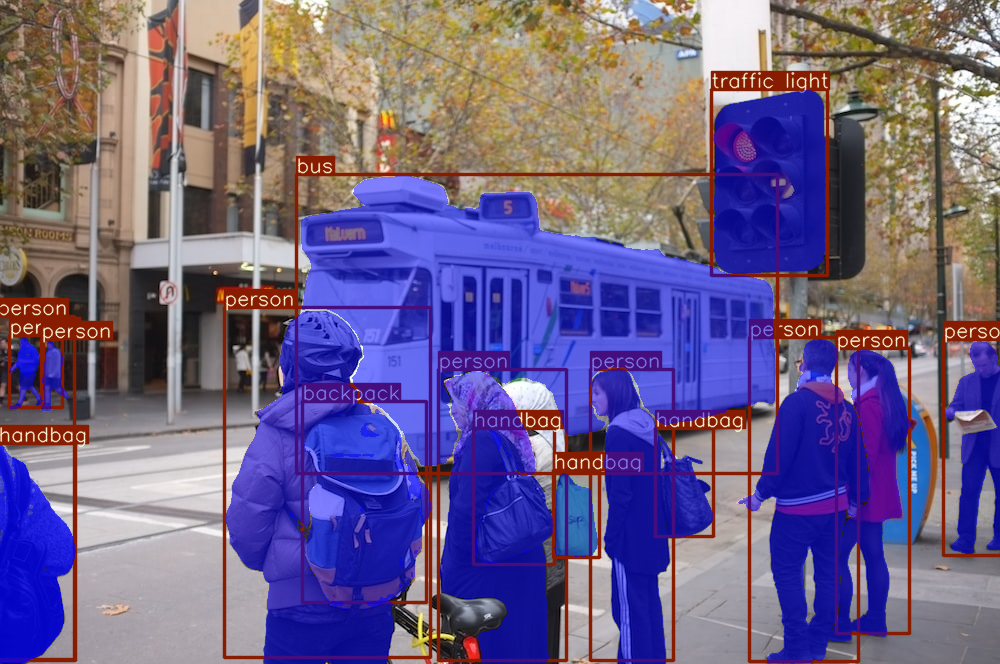

True

In [ ]:
result = list(model.predict(frame, conf=0.5))[0]
bbox_xyxys = result.prediction.bboxes_xyxy.tolist()
confidences = result.prediction.confidence
labels = result.prediction.labels.tolist()
label = [int(labels) for labels in labels]
print("Bounding Box Coorinates",bbox_xyxys)
print("Scores", confidences)
print("Class IDS", label)
masks = segment_object(bbox_xyxys, frame, label, filter_classes=None)
for mask in masks:
  segmented_mask = show_mask(mask.cpu().numpy(), plt.gca(), random_color=True)
  rearranged_mask = np.transpose(segmented_mask[:,:,:3], (2,0,1))
  frame = draw_segmented_mask(rearranged_mask, frame)
plt.close()
cv2_imshow(frame)
cv2.imwrite("example1.jpg", frame)

#**Example 2**

In [ ]:
frame = cv2.imread("/content/horses.jpg")

[2023-08-01 16:57:34] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


Bounding Box Coorinates [[435.5721435546875, 213.49415588378906, 595.5883178710938, 347.1511535644531], [253.26080322265625, 198.6053924560547, 417.64483642578125, 360.90045166015625], [3.0385220050811768, 193.32595825195312, 315.9303283691406, 409.4408264160156], [1.9370577335357666, 186.7931365966797, 155.3444366455078, 277.0562438964844]]
Scores [0.95703125 0.94433594 0.8769531  0.68066406]
Class IDS [17, 17, 17, 17]


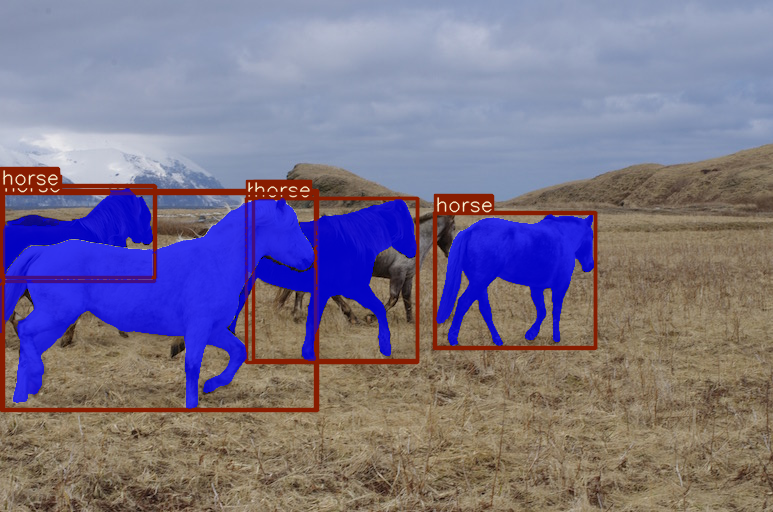

True

In [ ]:
result = list(model.predict(frame, conf=0.5))[0]
bbox_xyxys = result.prediction.bboxes_xyxy.tolist()
confidences = result.prediction.confidence
labels = result.prediction.labels.tolist()
label = [int(labels) for labels in labels]
print("Bounding Box Coorinates",bbox_xyxys)
print("Scores", confidences)
print("Class IDS", label)
masks = segment_object(bbox_xyxys, frame, label, filter_classes=None)
for mask in masks:
  segmented_mask = show_mask(mask.cpu().numpy(), plt.gca(), random_color=True)
  rearranged_mask = np.transpose(segmented_mask[:,:,:3], (2,0,1))
  frame = draw_segmented_mask(rearranged_mask, frame)
cv2_imshow(frame)
plt.close()
cv2.imwrite("example2.jpg", frame)

#**Example 3**

In [ ]:
frame = cv2.imread("/content/image2.jpg")

[2023-08-01 16:58:13] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


Bounding Box Coorinates [[19.245283126831055, 21.76100730895996, 461.25787353515625, 474.96856689453125], [424.08807373046875, 26.037736892700195, 631.8239135742188, 476.35223388671875], [49.496856689453125, 195.09434509277344, 188.7421417236328, 333.081787109375]]
Scores [0.98339844 0.9760742  0.97021484]
Class IDS [0, 0, 32]


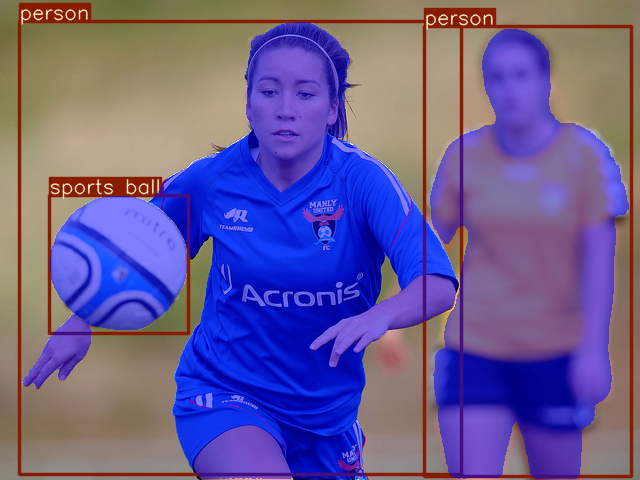

True

In [ ]:
result = list(model.predict(frame, conf=0.5))[0]
bbox_xyxys = result.prediction.bboxes_xyxy.tolist()
confidences = result.prediction.confidence
labels = result.prediction.labels.tolist()
label = [int(labels) for labels in labels]
print("Bounding Box Coorinates",bbox_xyxys)
print("Scores", confidences)
print("Class IDS", label)
masks = segment_object(bbox_xyxys, frame, label, filter_classes=None)
for mask in masks:
  segmented_mask = show_mask(mask.cpu().numpy(), plt.gca(), random_color=True)
  rearranged_mask = np.transpose(segmented_mask[:,:,:3], (2,0,1))
  frame = draw_segmented_mask(rearranged_mask, frame)
cv2_imshow(frame)
plt.close()
cv2.imwrite("example3.jpg", frame)